In [1]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap
import pickle 
import numpy as np
import plotly.express as px



c:\Users\Maods\.virtualenvs\renal-pathology-retrieval-P_udDvkW\lib\site-packages\umap\distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
c:\Users\Maods\.virtualenvs\renal-pathology-retrieval-P_udDvkW\lib\site-packages\umap\distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
c:\Users\Maods\.virtualenvs\renal-pa

In [ ]:
def create_static_2d_plot(data,labels):

    # Perform PCA for dimensionality reduction
    pca = PCA(n_components=2)
    pca_result = pca.fit_transform(data)

    # Perform t-SNE for dimensionality reduction
    tsne = TSNE(n_components=2, perplexity=30, n_iter=300)
    tsne_result = tsne.fit_transform(data)

    # Perform UMAP for dimensionality reduction
    umap_reducer = umap.UMAP(n_components=2)
    umap_result = umap_reducer.fit_transform(data)

    # Create a figure with subplots for each method
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    # Plot PCA clusters
    axes[0].scatter(pca_result[:, 0], pca_result[:, 1], c=labels, cmap='viridis', s=10)
    axes[0].set_title('PCA')
    axes[0].axis('off')

    # Plot t-SNE clusters
    axes[1].scatter(tsne_result[:, 0], tsne_result[:, 1], c=labels, cmap='viridis', s=10)
    axes[1].set_title('t-SNE')
    axes[1].axis('off')

    # Plot UMAP clusters
    axes[2].scatter(umap_result[:, 0], umap_result[:, 1], c=labels, cmap='viridis', s=10)
    axes[2].set_title('UMAP')
    axes[2].axis('off')

    plt.tight_layout()
    plt.show()

In [ ]:
def create_static_3d_plot(data,labels):
    
    

    pca = PCA(n_components=3)
    pca_result = pca.fit_transform(data)

    # Perform t-SNE for dimensionality reduction
    tsne = TSNE(n_components=3, perplexity=30, n_iter=300)
    tsne_result = tsne.fit_transform(data)

    # Perform UMAP for dimensionality reduction
    umap_reducer = umap.UMAP(n_components=3)
    umap_result = umap_reducer.fit_transform(data)

    # Create a 3D scatter plot for each method
    fig = plt.figure(figsize=(18, 6))

    # Plot PCA clusters in 3D
    ax1 = fig.add_subplot(131, projection='3d')
    ax1.scatter(pca_result[:, 0], pca_result[:, 1], pca_result[:, 2], c=labels, cmap='viridis', s=10)
    ax1.set_title('PCA')

    # Plot t-SNE clusters in 3D
    ax2 = fig.add_subplot(132, projection='3d')
    ax2.scatter(tsne_result[:, 0], tsne_result[:, 1], tsne_result[:, 2], c=labels, cmap='viridis', s=10)
    ax2.set_title('t-SNE')

    # Plot UMAP clusters in 3D
    ax3 = fig.add_subplot(133, projection='3d')
    ax3.scatter(umap_result[:, 0], umap_result[:, 1], umap_result[:, 2], c=labels, cmap='viridis', s=10)
    ax3.set_title('UMAP')

    plt.tight_layout()
    plt.show()
    return pca_result, tsne_result, umap_result

In [134]:
def create_din_3d_plot(data, labels, title):
    fig = px.scatter_3d(data_frame=data, x=0, y=1, z=2, color=labels, title=title, width=800, height=600,)
    fig.update_traces(marker=dict(size=3))
    fig.show()

In [138]:
def load_embeddings(pickle_file_path):
    with open(pickle_file_path, 'rb') as pickle_file:
        loaded_data_dict = pickle.load(pickle_file)

    # Convert lists to numpy arrays
    data = loaded_data_dict["embedding"]
    labels = np.array(loaded_data_dict["labels"])
    return data, labels, loaded_data_dict

# VGG16

In [106]:
path = '../data_output/embeddings/vgg16_4096_pretrained.pickle'

data, labels, result = load_embeddings(path)

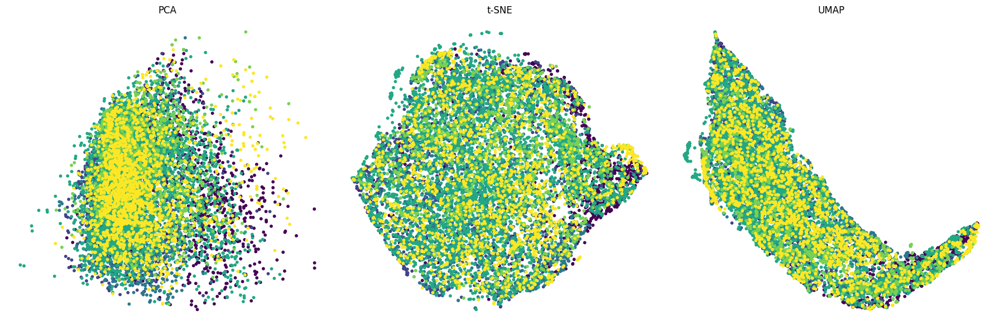

In [101]:
create_static_2d_plot(data,labels)

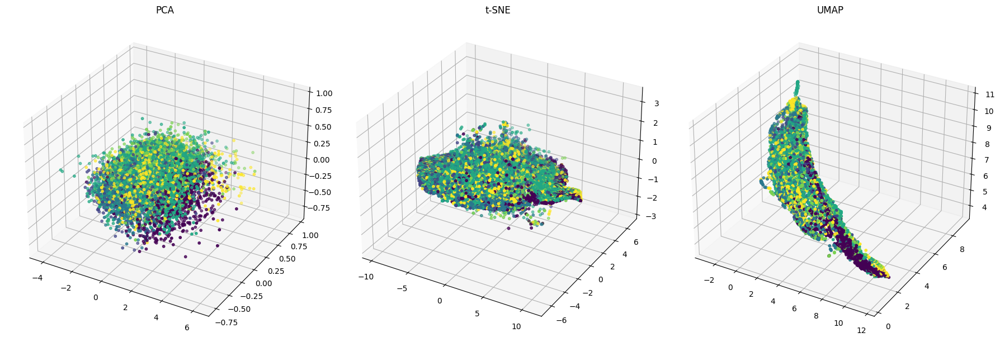

In [102]:
create_static_3d_plot(data,labels)

In [6]:
create_din_3d_plot(pca_result, labels, 'PCA Clusters')
create_din_3d_plot(tsne_result, labels, 't-SNE Clusters')
create_din_3d_plot(umap_result, labels, 'UMAP Clusters')

# Efficiente Net B0

In [107]:
path = '../data_output/embeddings/efficientnetb0_4096_pretrained.pickle'
data, labels = load_embeddings(path)

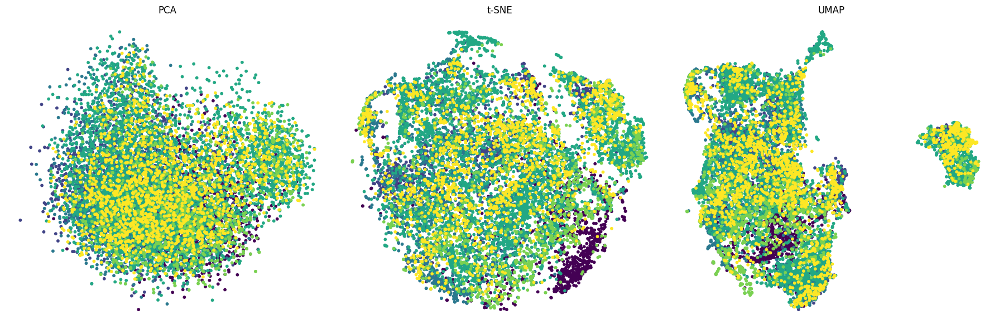

In [108]:
create_static_2d_plot(data,labels)

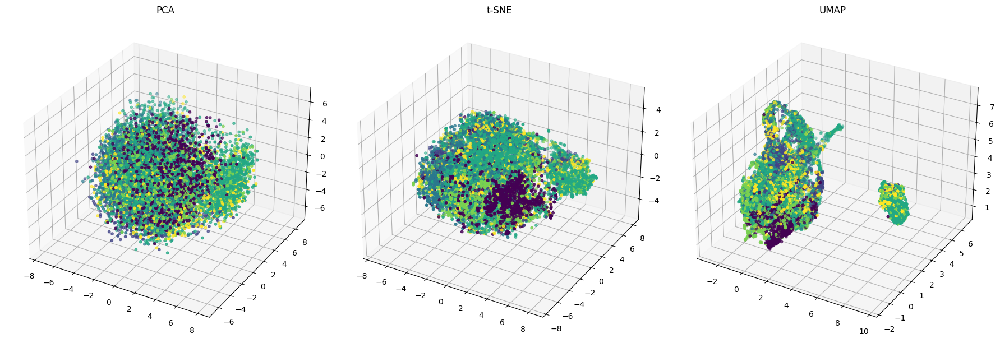

In [109]:
pca_result, tsne_result, umap_result = create_static_3d_plot(data,labels)

In [110]:
create_din_3d_plot(pca_result, labels, 'PCA Clusters')
create_din_3d_plot(tsne_result, labels, 't-SNE Clusters')
create_din_3d_plot(umap_result, labels, 'UMAP Clusters')

# ViT

In [139]:
path = '../data_output/embeddings/vit768_pretrained.pickle'
data, labels, result = load_embeddings(path)

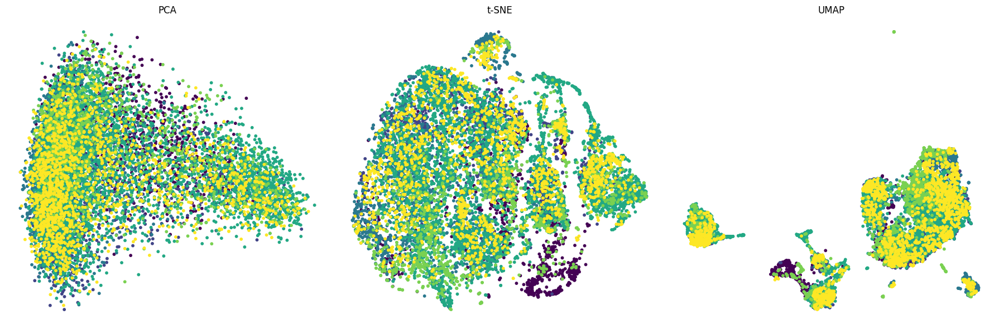

In [112]:
create_static_2d_plot(data,labels)

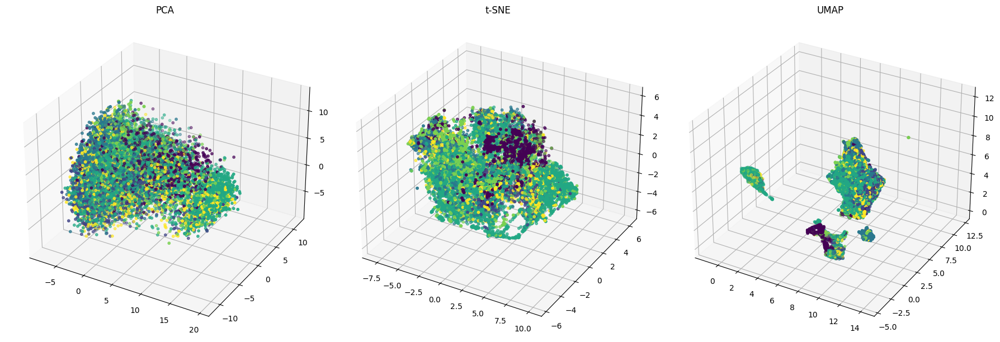

In [113]:
pca_result, tsne_result, umap_result = create_static_3d_plot(data,labels)

In [143]:
create_din_3d_plot(pca_result, labels, 'PCA Clusters')
create_din_3d_plot(tsne_result, labels, 't-SNE Clusters')
create_din_3d_plot(umap_result, labels, 'UMAP Clusters')

In [116]:
df = px.data.iris()

In [117]:
result

,sepal_length,sepal_width,petal_length,petal_width,species,species_id
0,5.1,3.5,1.4,0.2,setosa,1
1,4.9,3.0,1.4,0.2,setosa,1
2,4.7,3.2,1.3,0.2,setosa,1
3,4.6,3.1,1.5,0.2,setosa,1
4,5.0,3.6,1.4,0.2,setosa,1
...,...,...,...,...,...,...
145,6.7,3.0,5.2,2.3,virginica,3
146,6.3,2.5,5.0,1.9,virginica,3
147,6.5,3.0,5.2,2.0,virginica,3
148,6.2,3.4,5.4,2.3,virginica,3
